In [1]:
%load_ext autoreload
%autoreload 2

In [257]:
from saxs_data_processing import io, target_comparison, subtract, manipulate

import matplotlib.pyplot as plt
import numpy as np

from apdist import AmplitudePhaseDistance as dist

from scipy.interpolate import UnivariateSpline, CubicSpline, BSpline, make_interp_spline
from scipy.signal import savgol_filter

from scipy import interpolate

In [3]:
## Need to re-run all existing data here


## Load measurement data

In [330]:
bio_conf = 24
root_dirs = ['/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_15_Highlights_replicates/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_11_randomV3_round2/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_07_randomcampaignV3/data/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_17_randomBaselineV4/data/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/', 
             '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_05_optimizationRound1/']

In [348]:
data, data_fps, _ = io.load_data_files_biocube(root_dirs, bio_conf)

/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:148: UserWarning: Duplicate UUID found for b8953350-d5ad-4c99-b929-ebfe8febd0df. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:148: UserWarning: Duplicate UUID found for ea0d2ca6-8818-45f8-b5e3-04858133284a. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:148: UserWarning: Duplicate UUID found for 0ec4dd81-7487-4689-96b9-b0f646a2047d. Check your file naming
  warnings.warn(


## Load backgrounds and map to measurement data

In [349]:
# map data to backgrounds
background_fps = ['/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03210_B9-T1_Ethanol_background__000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_07_randomcampaignV3/data/03218_D1-T1_Ethanol_background_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_11_randomV3_round2/03289_H6-T2_EtOH_background_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_15_Highlights_replicates/03357_D5-T2_Background_1_EtOH_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_17_randomBaselineV4/data/03439_C1-T2_EtOH_1_000.dat',
                  '/home/bgpelkie/gdrive_uw/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_05_optimizationRound1/03533_F9-T1_Ethanol_background_1_000.dat']

# map root filepath to esaxs background
background_mapping = {}

for bcg_fp in background_fps:
    bkg_data = io.read_1D_data(bcg_fp)
    root_dir = '/'.join(bcg_fp.split('/')[:-1])
    background_mapping[root_dir] = bkg_data

In [350]:
uuid2bkg = {}
uuid2root = {}
for uuid_val, fp in data_fps.items():
    root_dir = '/'.join(fp.split('/')[:-1])
    bkg = background_mapping[root_dir]

    uuid2bkg[uuid_val] = bkg

## Subtract and clip measurements

In [343]:
q_min = 0.002
q_max = 0.03

In [355]:
subtracted_data = {}
for uuid_val, signal in data.items():
    background = uuid2bkg[uuid_val]
    subtracted = subtract.chop_subtract(signal[0], background[0], hiq_thresh=1)
    if subtracted is not None:
        subtracted = subtracted[subtracted['q'] < q_max]

    if subtracted is not None:
        if len(subtracted) < 10:
            subtracted = None

    subtracted_data[uuid_val] = subtracted
    

In [344]:
subtracted_data_raw = {}
for uuid_val, signal in data.items():
    background = uuid2bkg[uuid_val]
    subtracted = subtract.subtract_background(signal[0], background[0])

    subtracted = subtracted[subtracted['q'] > q_min]
    subtracted = subtracted[subtracted['q'] < q_max]

    if subtracted is not None:
        if len(subtracted) < 10:
            subtracted = None

    subtracted_data_raw[uuid_val] = subtracted

/tmp/ipykernel_32447/1964056947.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


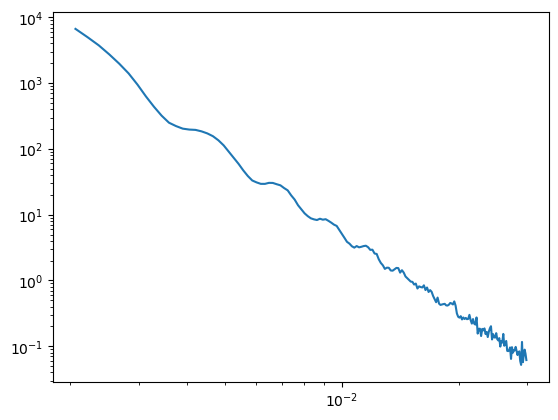

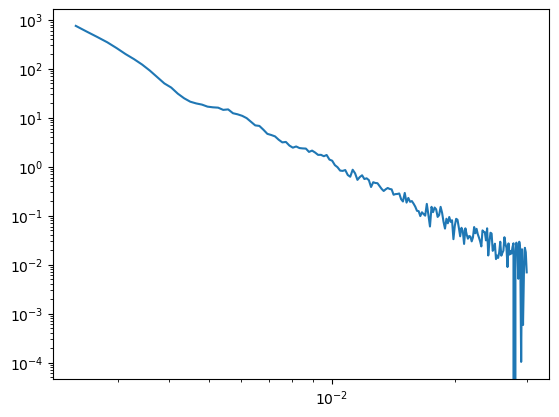

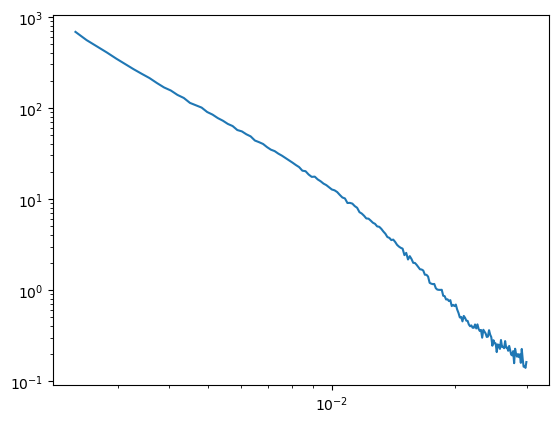

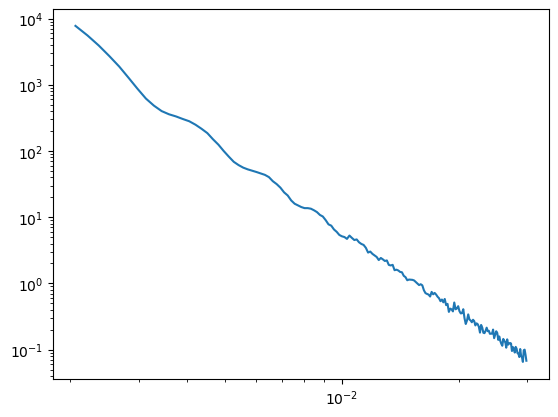

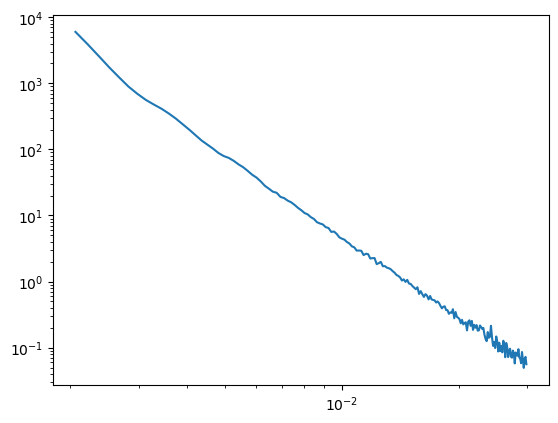

...

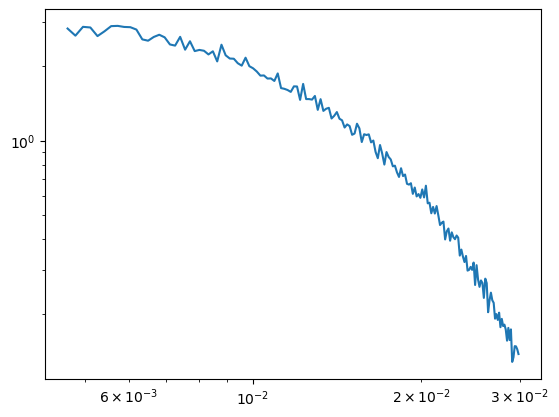

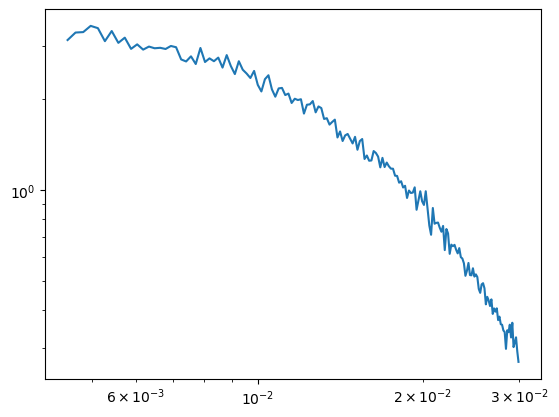

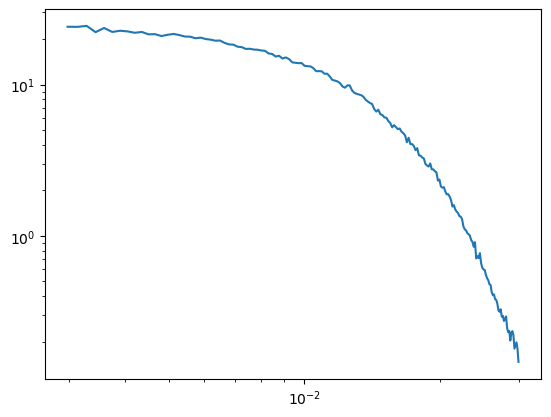

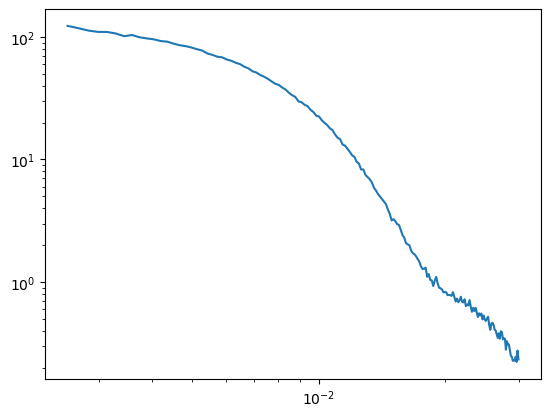

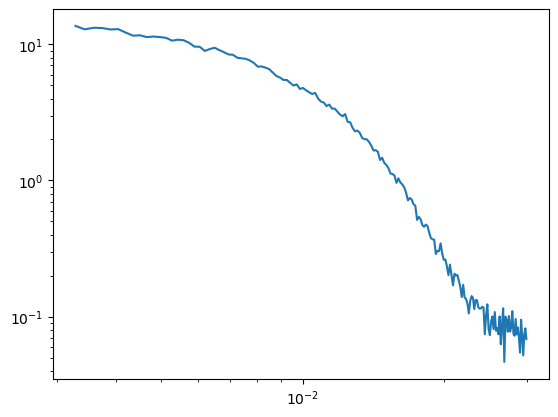

In [356]:
for uuid_val, data_val in subtracted_data.items():
    if data_val is not None:
        fig, ax = plt.subplots()
        ax.loglog(data_val['q'], data_val['I'])

In [352]:
data_val

## Q range normalization

### Find q min and q max for entire dataset


In [317]:
q_min = None
q_max = None

q_min_uuid = None
q_max_uuid = None

bad_uuids = []
for uuid_val, data in subtracted_data.items():
    if data is not None:
        if len(data) > 100:
            val_q_min = data['q'].min()
            val_q_max = data['q'].max()
        
            if q_min is None:
                q_min = val_q_min
                q_max = val_q_max
                q_min_uuid = uuid_val
                q_max_uuid = uuid_val
            else:
                if val_q_min > q_min:
                    q_min = val_q_min
                    q_min_uuid = uuid_val
                if val_q_max < q_max:
                    q_max = val_q_max
                    q_max_uuid = uuid_val
                
        else:
            bad_uuids.append(uuid_val)

/tmp/ipykernel_32447/1746416669.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


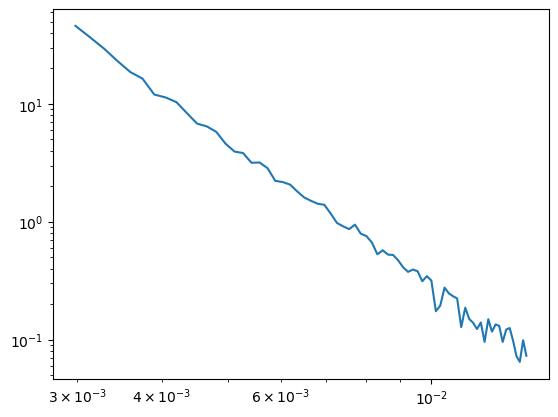

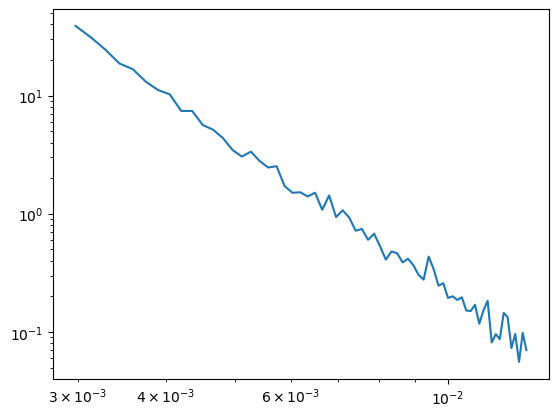

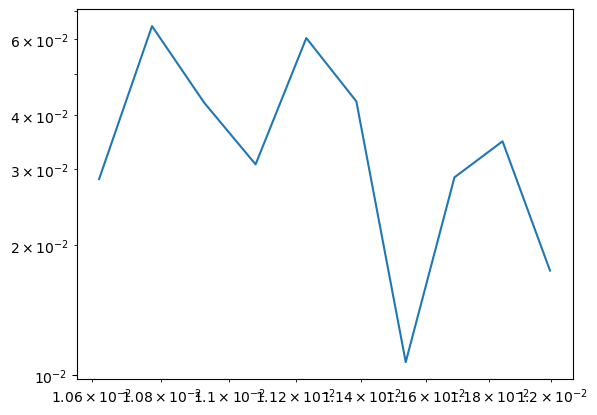

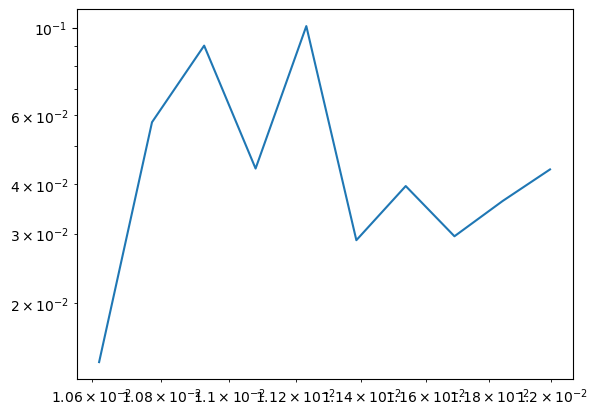

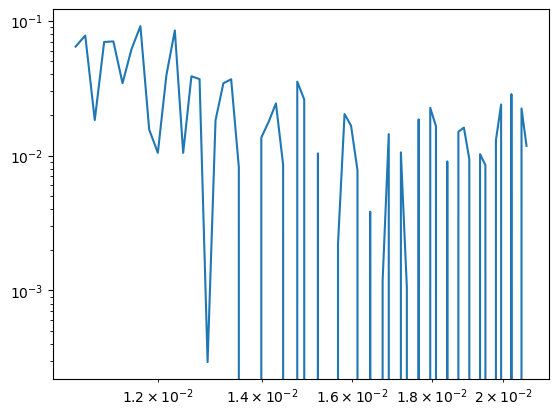

...

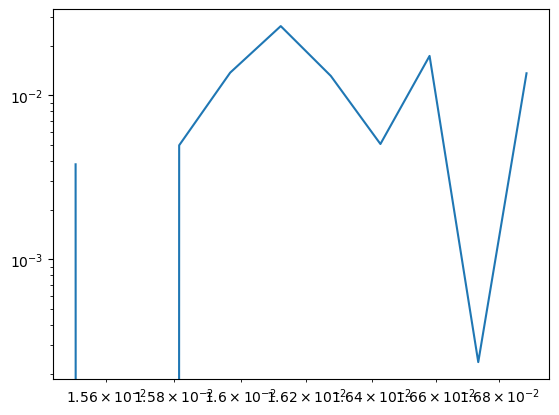

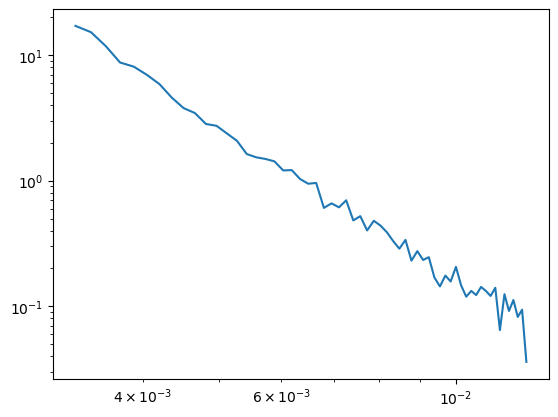

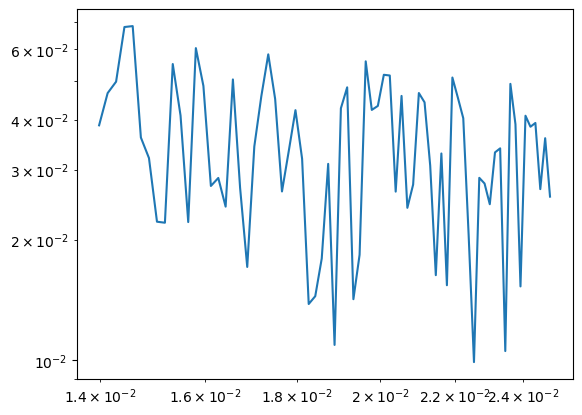

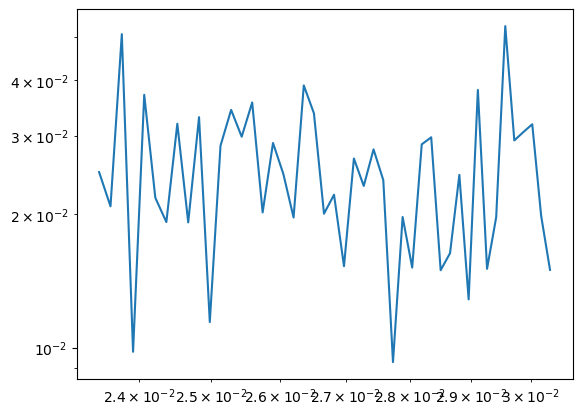

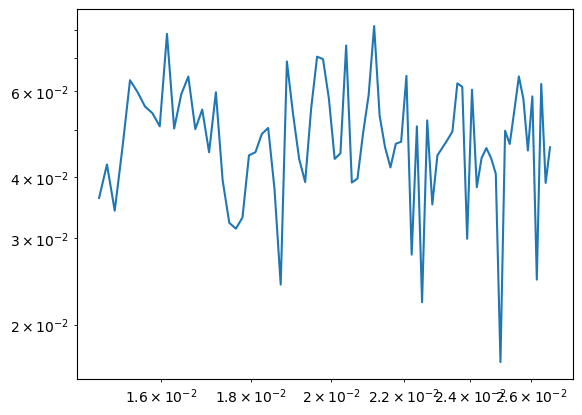

In [310]:
for uuid_val in bad_uuids:
    data = subtracted_data[uuid_val]
    fig, ax = plt.subplots()

    ax.loglog(data['q'], data['I'])

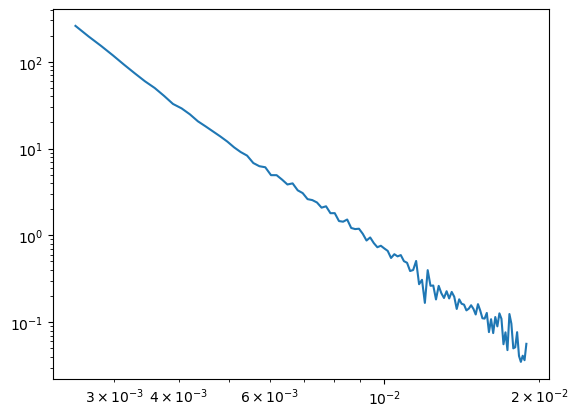

In [319]:
data = subtracted_data[q_max_uuid]

plt.loglog(data['q'], data['I'])

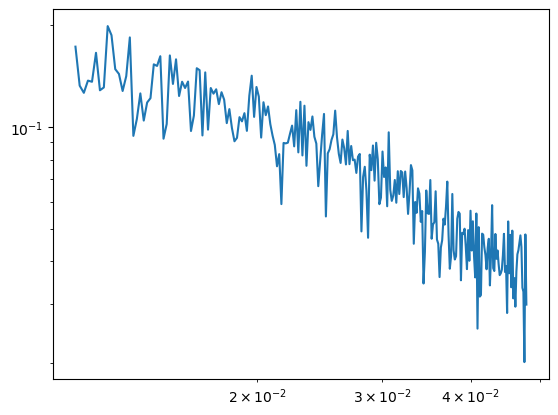

In [320]:
data = subtracted_data[q_min_uuid]

plt.loglog(data['q'], data['I'])

In [325]:
q_mins = []
q_maxs = []
for uuid_val, data in subtracted_data.items():
    if data is not None:
        q_mins.append(data['q'].min())
        q_maxs.append(data['q'].max())
                  

(array([105.,  19.,   0.,   4.,   2.,   3.,   0.,   1.,   0.,   0.]),
 array([0.   , 0.003, 0.006, 0.009, 0.012, 0.015, 0.018, 0.021, 0.024,
        0.027, 0.03 ]),
 <BarContainer object of 10 artists>)

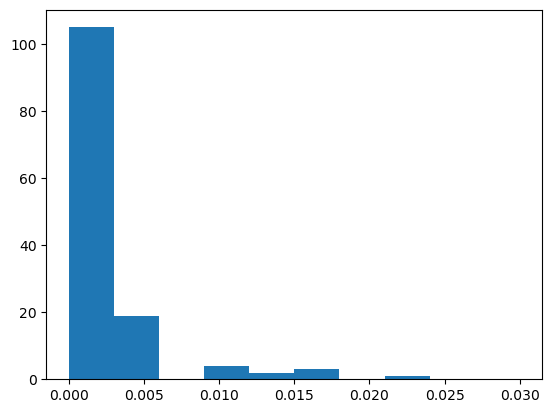

In [340]:
plt.hist(q_mins, range = (0, 0.03))

(array([11., 27., 52., 20., 12.,  7.,  4.,  0.,  1.,  1.]),
 array([0.00496639, 0.01511312, 0.02525984, 0.03540656, 0.04555329,
        0.05570001, 0.06584673, 0.07599346, 0.08614018, 0.0962869 ,
        0.10643363]),
 <BarContainer object of 10 artists>)

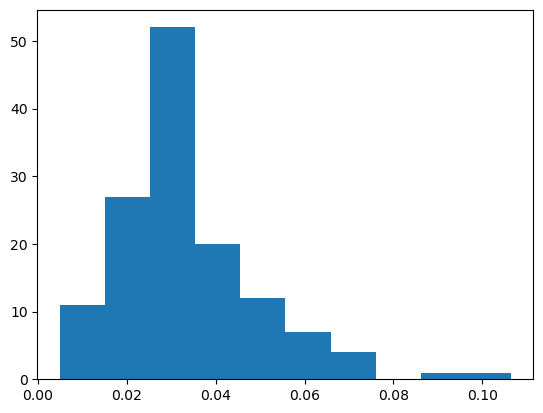

In [328]:
plt.hist(q_maxs)

In [342]:
np.mean(q_maxs)

0.033935039647816134

## Denoise

In [357]:
test_data = subtracted_data['01cddefc-e6a6-41aa-9052-06286b12b8fe']

In [358]:
test_q = np.log10(test_data['q'].to_numpy())
test_I = np.log10(test_data['I'].to_numpy())

In [359]:
I_savgol = savgol_filter(test_I, 25, 3)

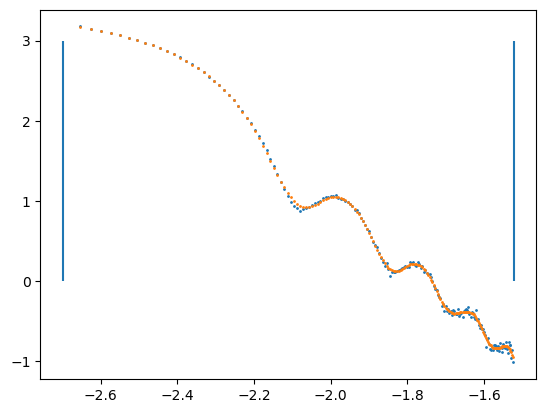

In [360]:
plt.scatter(test_q, test_I, s = 1)
plt.scatter(test_q, I_savgol, s = 1)
plt.vlines(np.log10(q_min), 0, 3)
plt.vlines(np.log10(q_max), 0, 3)

## Interpolate measured data with a spline

In [362]:
q_grid = np.linspace(np.log10(test_data['q'].min()), np.log10(test_data['q'].max()), 1001)
#q_grid = np.linspace(np.log10(q_min), np.log10(q_max), 501)

In [363]:
spl = make_interp_spline(test_q, I_savgol, k = 3)

In [364]:
spl = BSpline(*interpolate.splrep(test_q, I_savgol, s = 0.05))

In [365]:
I_spl = spl(q_grid)

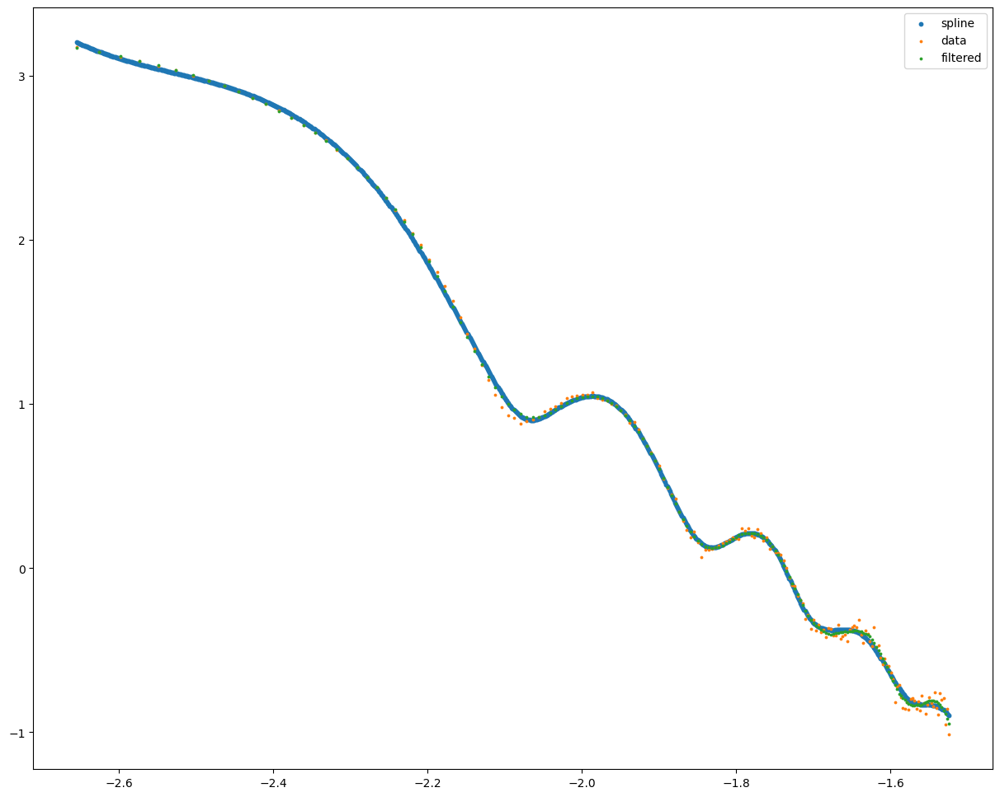

In [366]:
fig, ax = plt.subplots(figsize = (15,12))
ax.scatter(q_grid, I_spl, s=10, label = 'spline')
ax.scatter(test_q, test_I, s = 3, label = 'data')
ax.scatter(test_q, I_savgol, s = 3, label = 'filtered')

ax.legend()


## calculate scattering distance metric

In [237]:
target_r_nm = 60
target_r_angs = target_r_nm*10
target_pdi = 0.08

sld_silica = 8.575
sld_etoh = 9.611

In [136]:
optim_kwargs = {"optim":"DP", "grid_dim":10}

In [ ]:
target

In [31]:
amp_dist = {}
phase_dist = {}

for uuid_val, data_val in subtracted_data.items():

    if data_val is None:
        continue
    else:
        q = data_val['q'].to_numpy()
    
        meas_I = data_val['I'].to_numpy()
    
        #calculate target scattering
        target_I = target_comparison.target_intensities(q, target_r_angs, target_pdi, sld_silica, sld_etoh)

        #normalize
        target_I = target_I/target_I[0]
        meas_I = meas_I/meas_I[0]
    
        try:
            amp, phase = dist(np.log10(q), np.log10(target_I), np.log10(meas_I), **optim_kwargs)
        
            amp_dist[uuid_val] = amp
            phase_dist[uuid_val] = phase
    
        except:
            print(f'Error on {uuid_val}')
    


        

/tmp/ipykernel_32447/479857089.py:21: RuntimeWarning: invalid value encountered in log10
  amp, phase = dist(np.log10(q), np.log10(target_I), np.log10(meas_I), **optim_kwargs)


## Plot sorted results - amplitude

In [12]:
uuids = np.array(list(amp_dist.keys()))
rmses = list(amp_dist.values())
uuid_sorted = uuids[np.argsort(rmses)]

/tmp/ipykernel_32447/2118753370.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


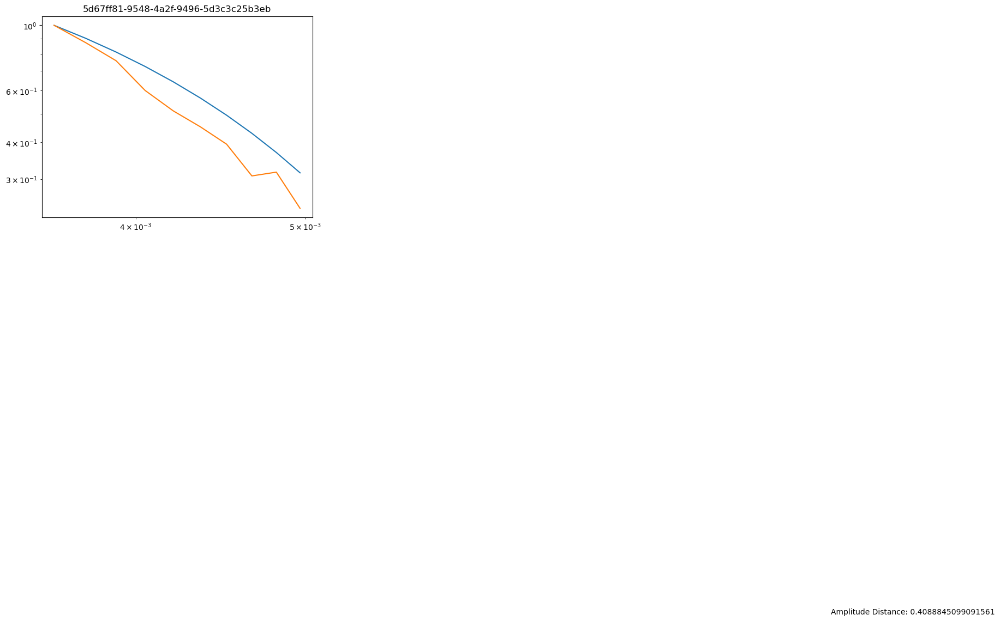

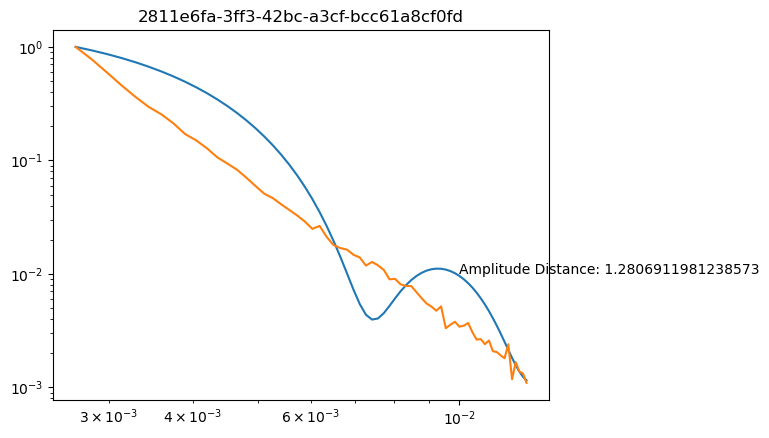

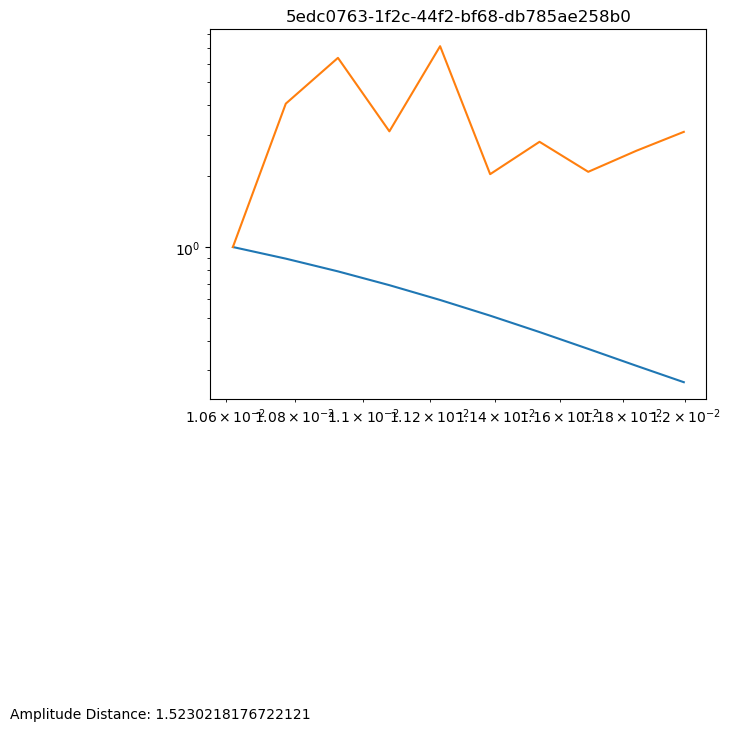

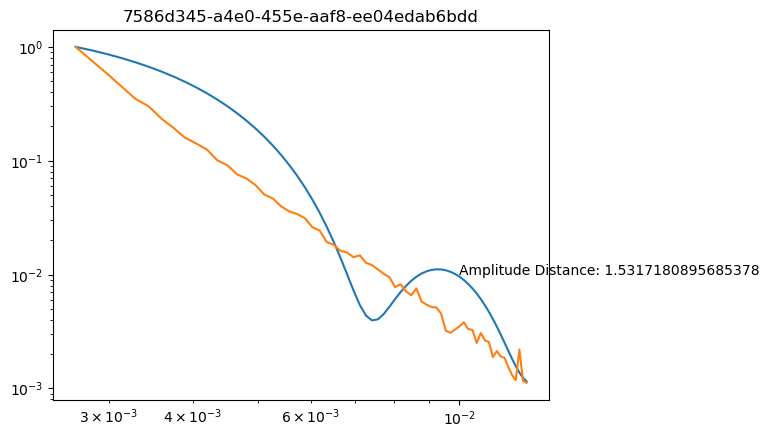

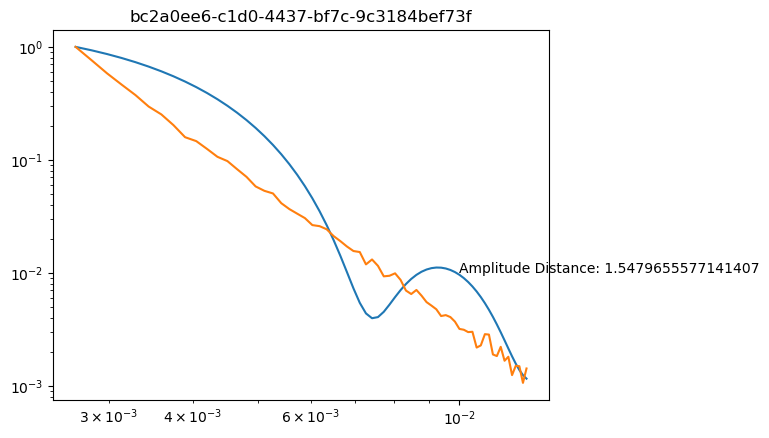

...

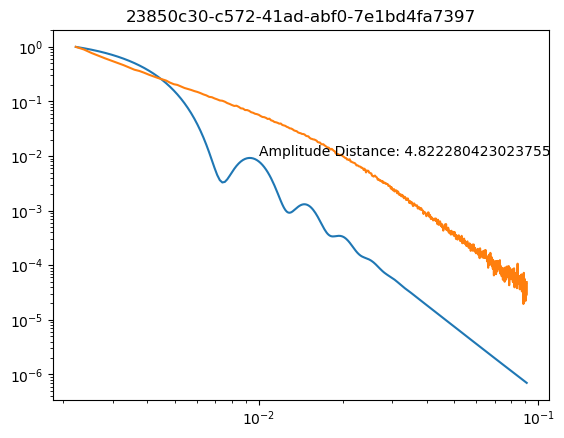

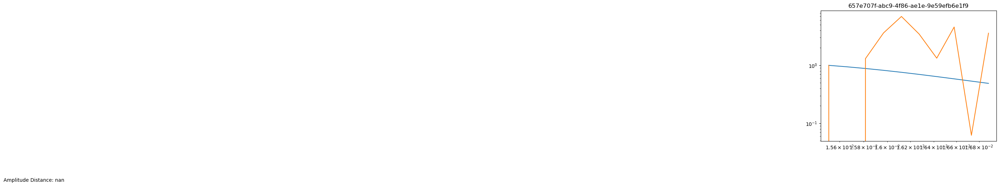

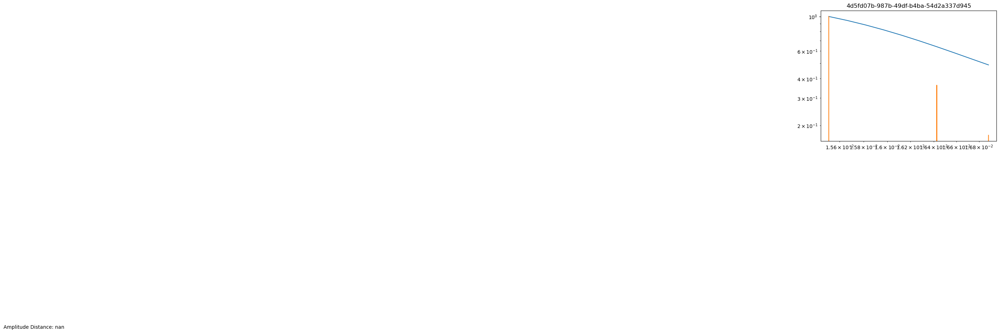

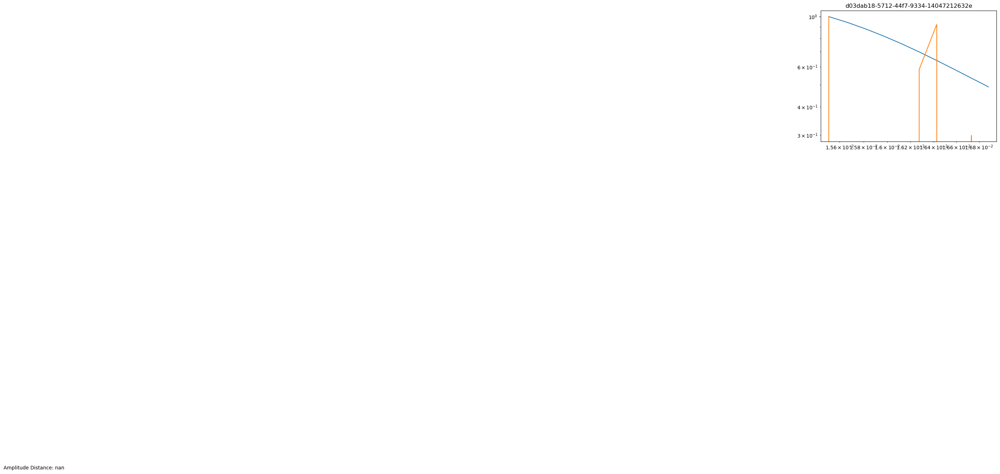

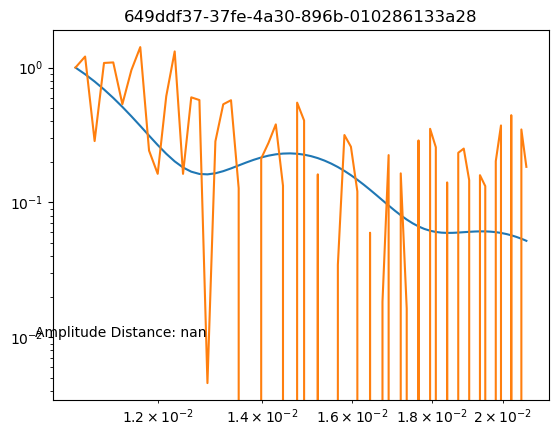

ValueError: Image size of 82044x1099 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 640x480 with 1 Axes>

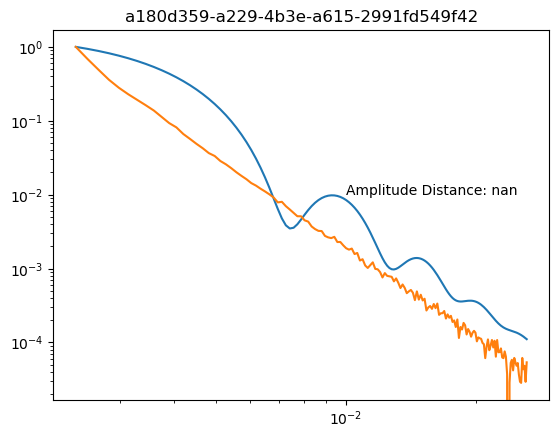

In [20]:
for uuid_val in uuid_sorted:
    #try:
    data_val = subtracted_data[uuid_val]
    #except KeyError:
    #    print(uuid_val)
    #    continue
    if data_val is None:
        continue
    else:
        meas_I = data_val['I'].to_numpy()
        q = data_val['q'].to_numpy()
        target_I = target_comparison.target_intensities(q, target_r_angs, target_pdi, sld_silica, sld_etoh)
        
        meas_norm = meas_I/(meas_I[0])
        target_norm = target_I/target_I[0]

        distance = amp_dist[uuid_val]

        fig, ax = plt.subplots()
        ax.loglog(q, target_norm)
        ax.loglog(q, meas_norm)
        ax.set_title(uuid_val)
        ax.text(0.01, 0.01, f'Amplitude Distance: {distance}')

## Plot sorted results - phase distance

In [25]:
uuids = np.array(list(phase_dist.keys()))
rmses = list(phase_dist.values())
uuid_sorted_phase = uuids[np.argsort(rmses)]

/tmp/ipykernel_32447/998524878.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


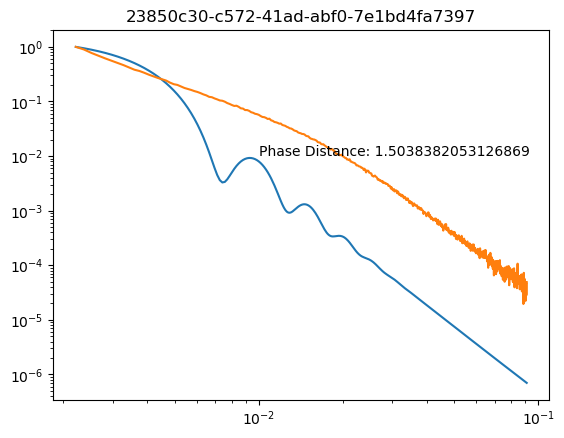

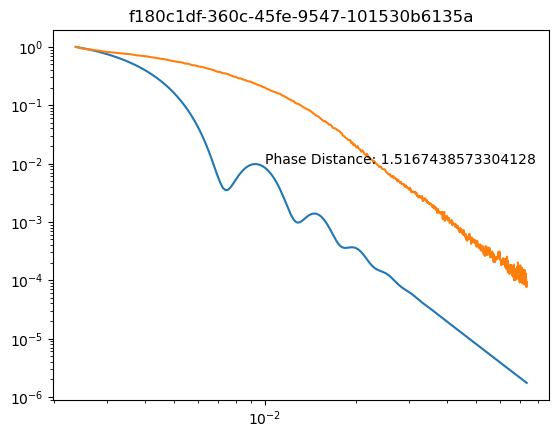

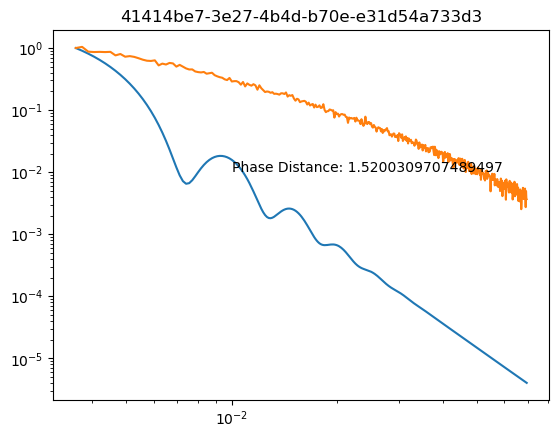

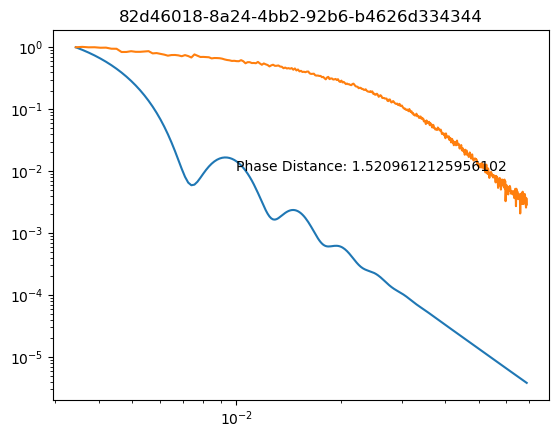

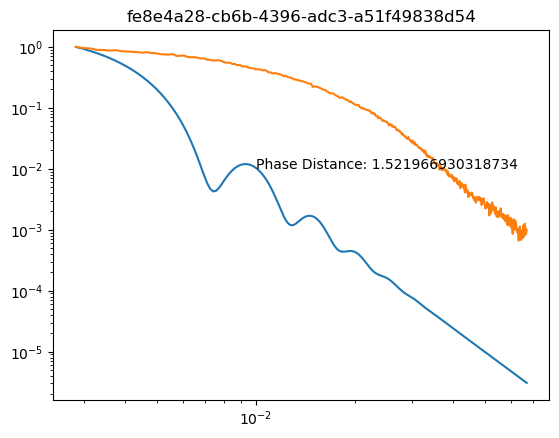

...

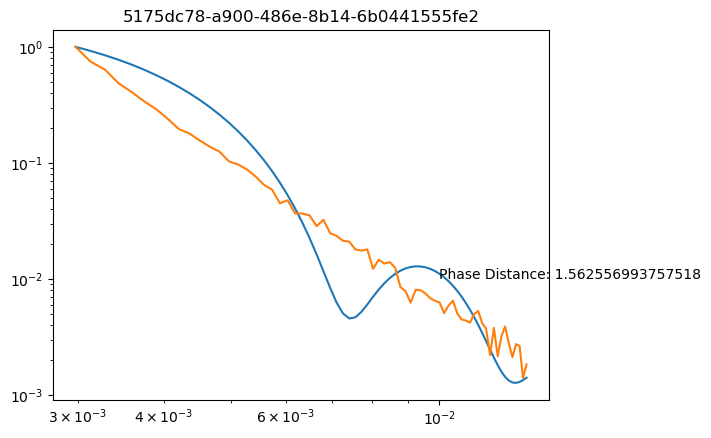

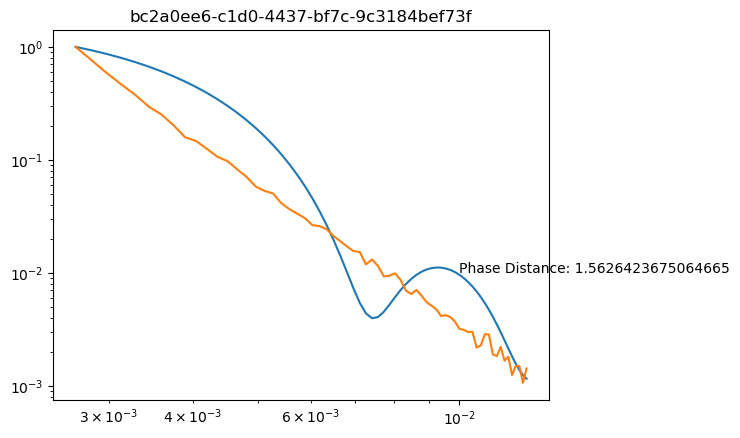

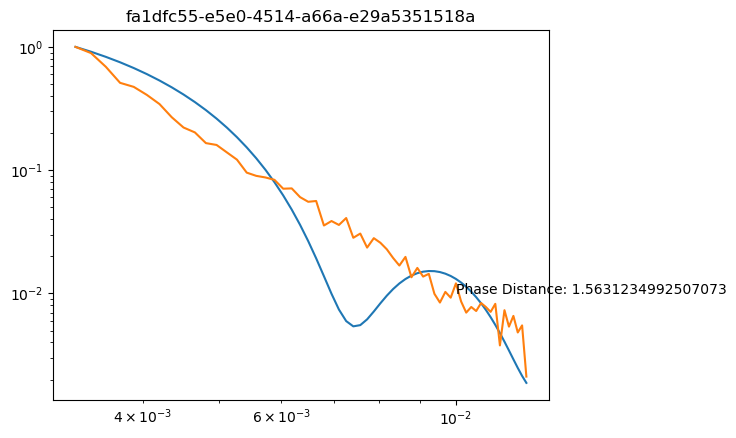

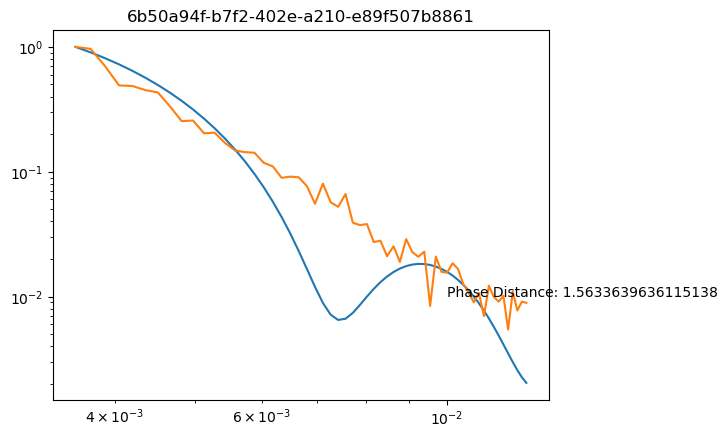

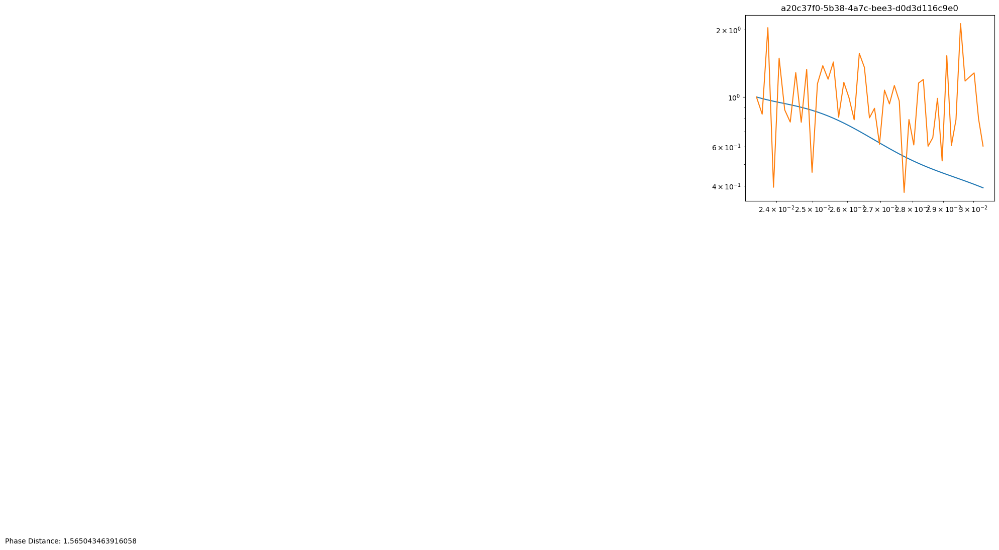

ValueError: Image size of 82044x1099 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 640x480 with 1 Axes>

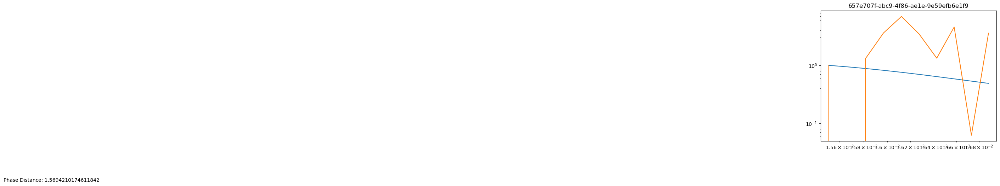

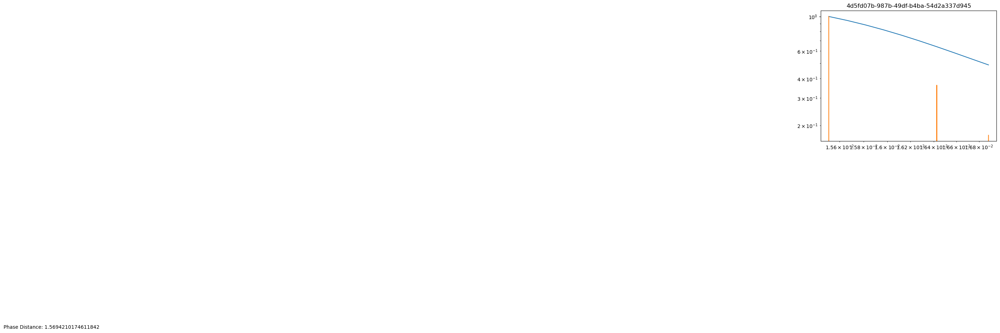

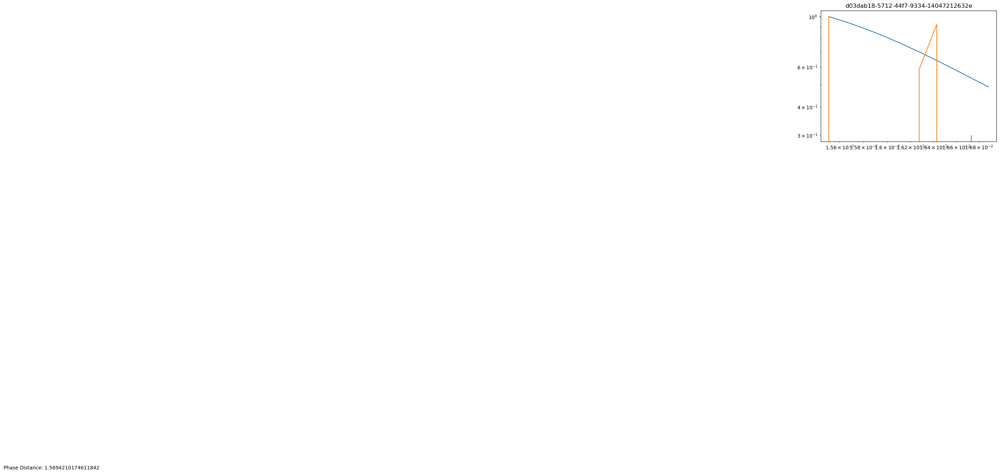

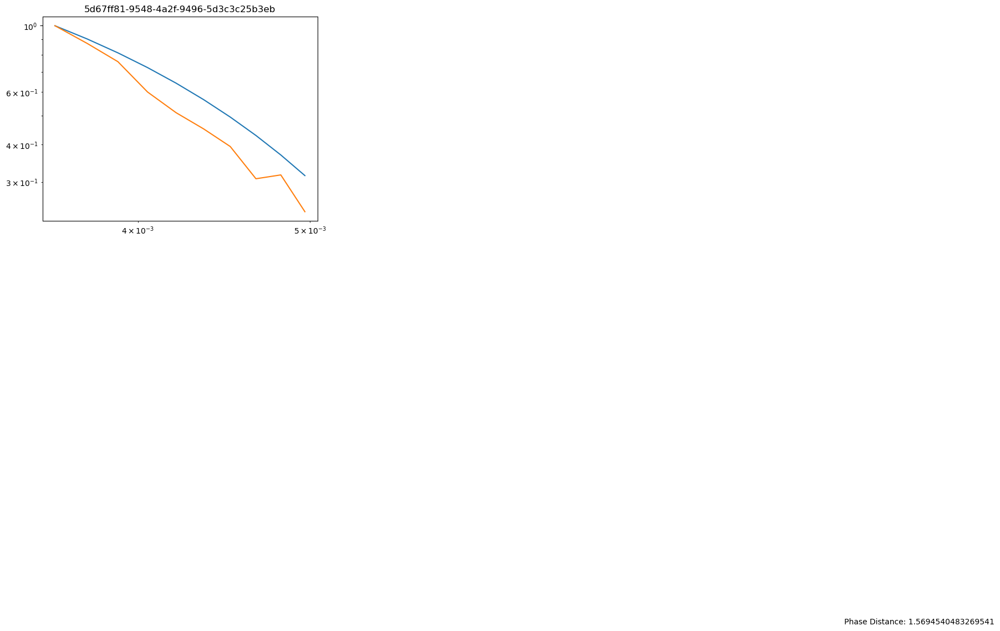

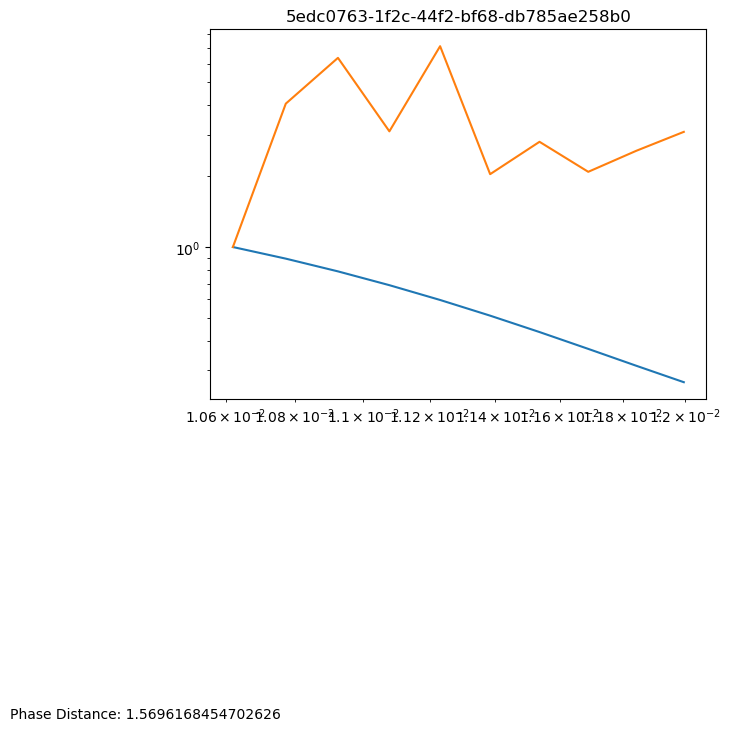

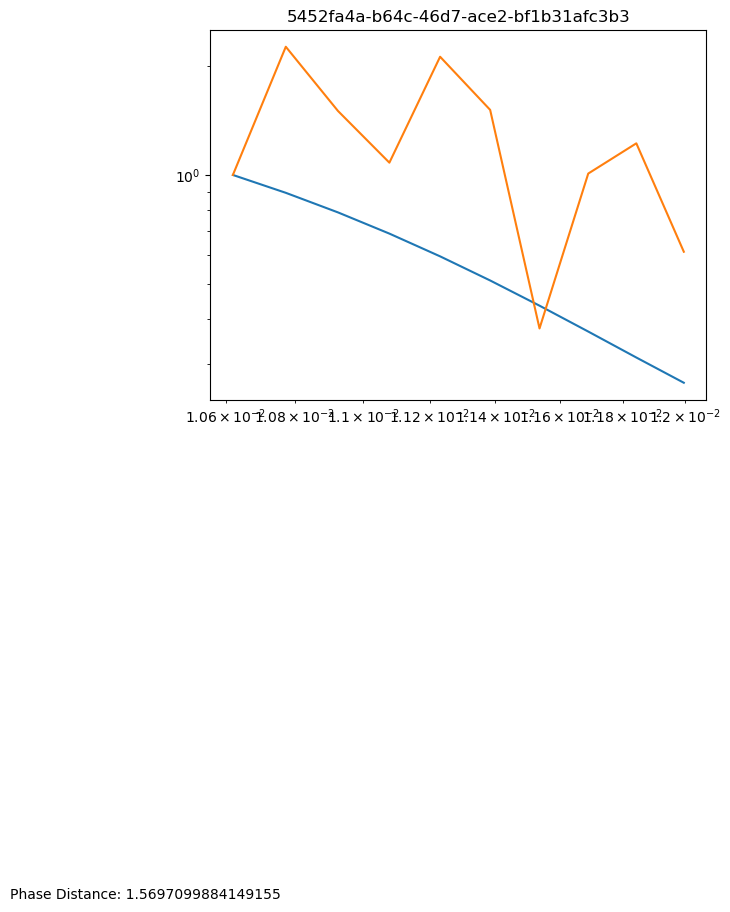

In [26]:
for uuid_val in uuid_sorted_phase:
    #try:
    data_val = subtracted_data[uuid_val]
    #except KeyError:
    #    print(uuid_val)
    #    continue
    if data_val is None:
        continue
    else:
        meas_I = data_val['I'].to_numpy()
        q = data_val['q'].to_numpy()
        target_I = target_comparison.target_intensities(q, target_r_angs, target_pdi, sld_silica, sld_etoh)
        
        meas_norm = meas_I/(meas_I[0])
        target_norm = target_I/target_I[0]

        distance = phase_dist[uuid_val]

        fig, ax = plt.subplots()
        ax.loglog(q, target_norm)
        ax.loglog(q, meas_norm)
        ax.set_title(uuid_val)
        ax.text(0.01, 0.01, f'Phase Distance: {distance}')

## Plot sorted results - sum of amp + phase

In [28]:
sum_ap = {}
for uuid_val, amp in amp_dist.items():
    phase = phase_dist[uuid_val]
    sum_ap[uuid_val] = amp + phase

In [29]:
uuids = np.array(list(sum_ap.keys()))
rmses = list(sum_ap.values())
uuid_sorted_sum = uuids[np.argsort(rmses)]

/tmp/ipykernel_32447/2963323792.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


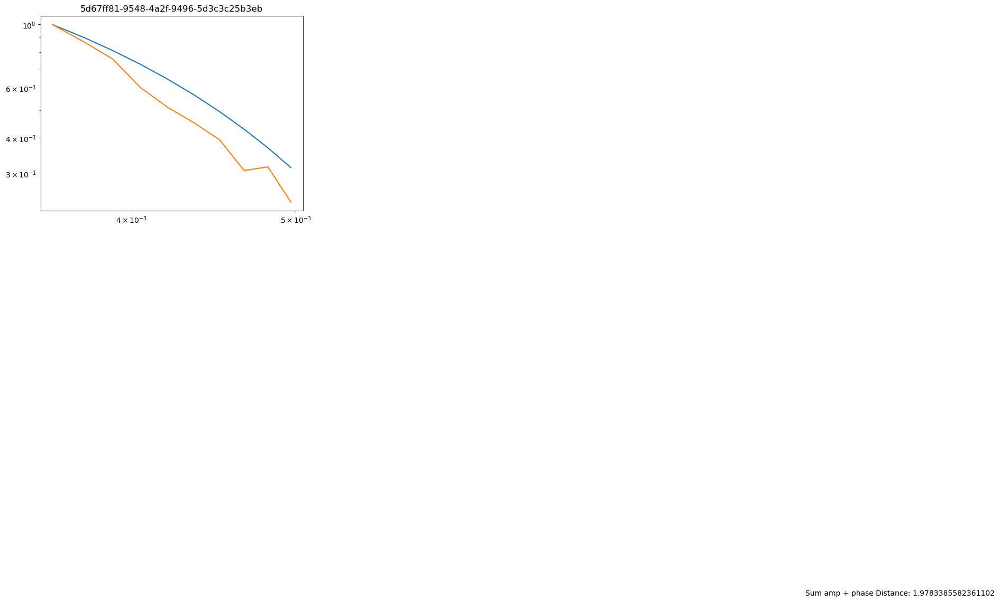

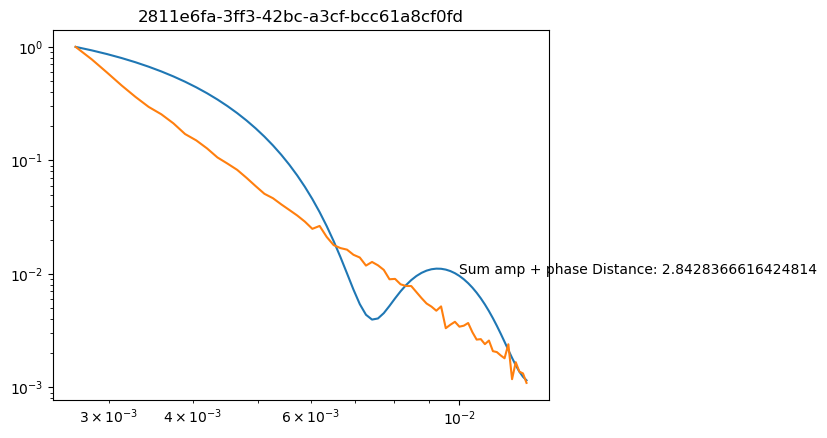

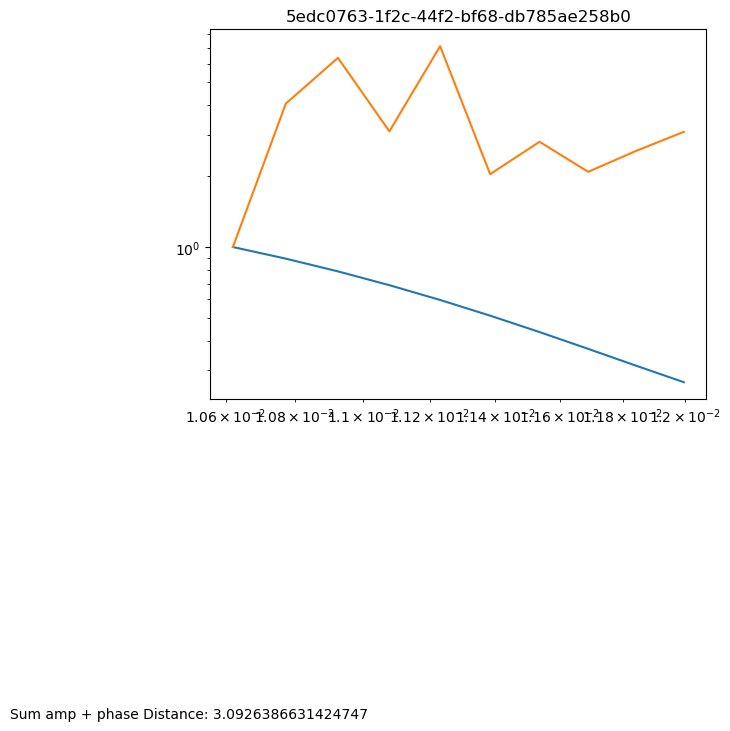

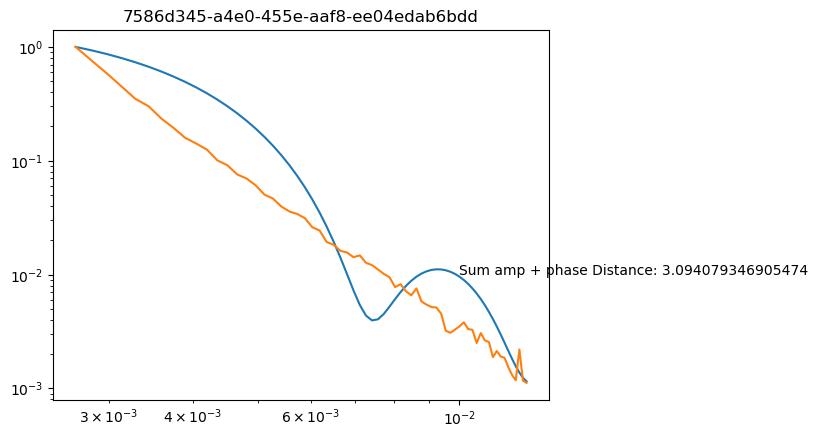

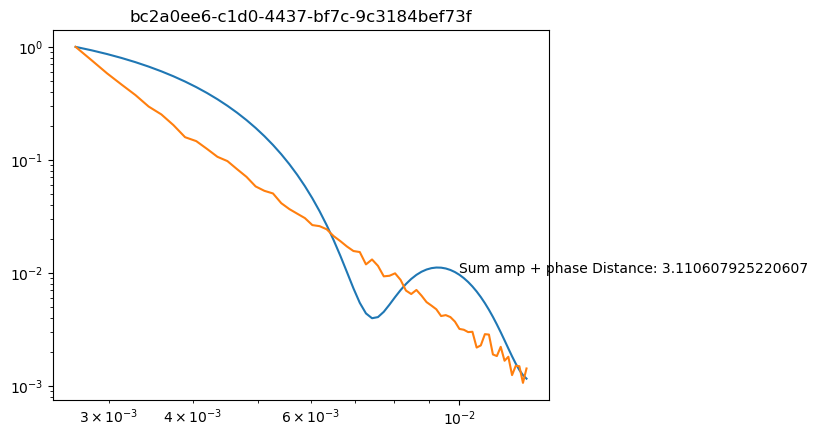

...

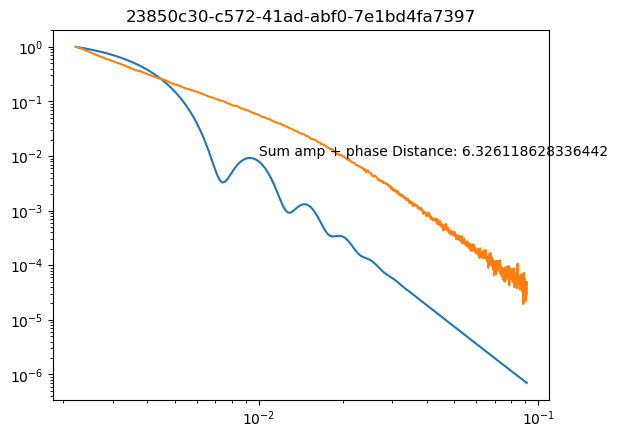

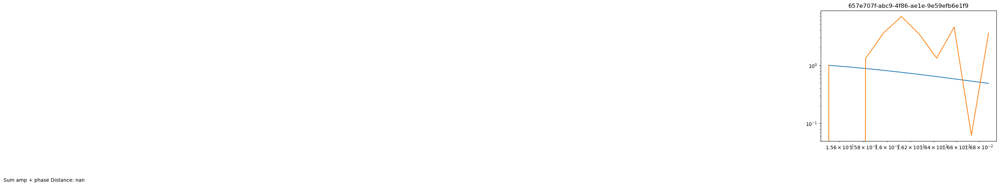

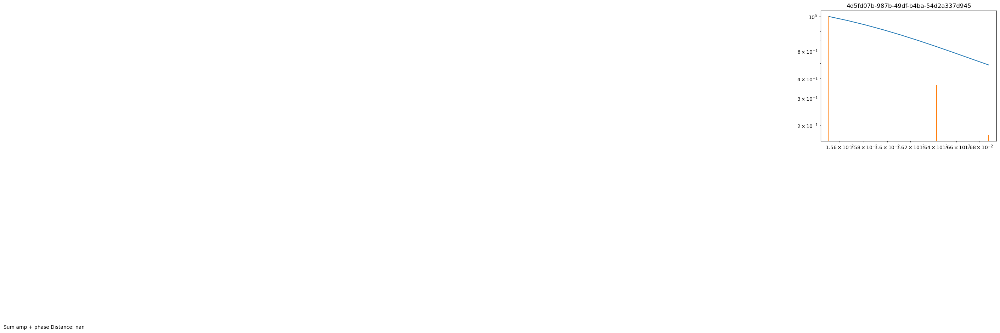

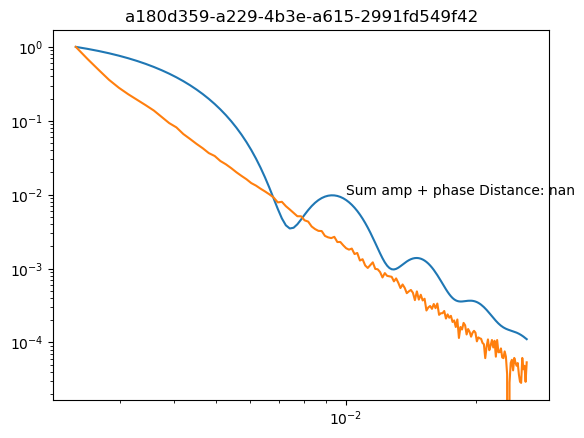

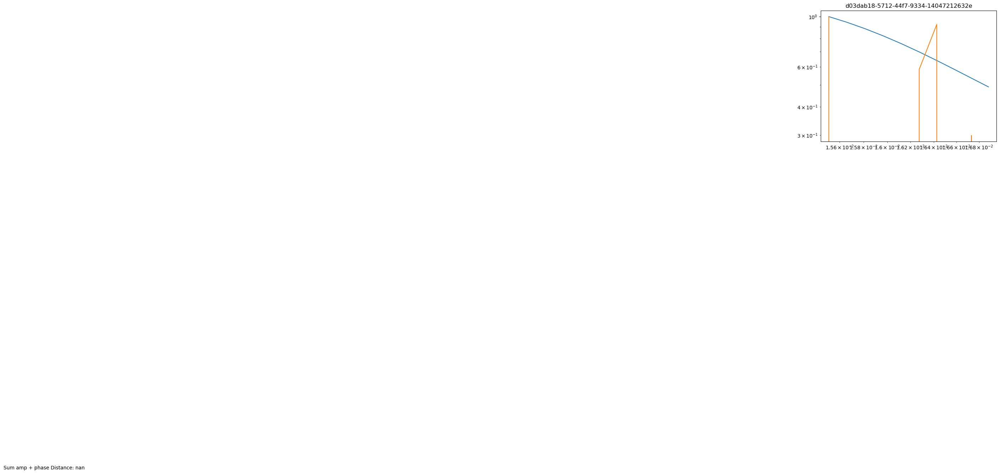

ValueError: Image size of 82044x1099 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 640x480 with 1 Axes>

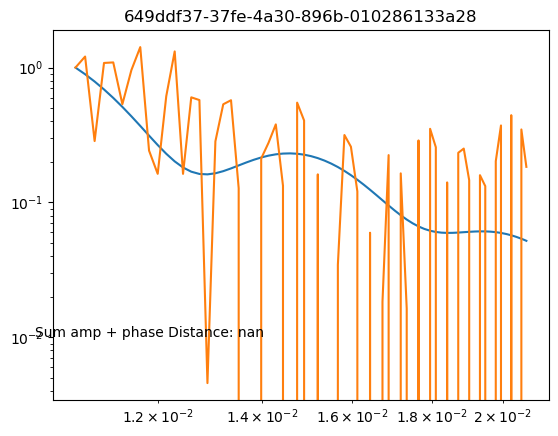

In [30]:
for uuid_val in uuid_sorted_sum:
    #try:
    data_val = subtracted_data[uuid_val]
    #except KeyError:
    #    print(uuid_val)
    #    continue
    if data_val is None:
        continue
    else:
        meas_I = data_val['I'].to_numpy()
        q = data_val['q'].to_numpy()
        target_I = target_comparison.target_intensities(q, target_r_angs, target_pdi, sld_silica, sld_etoh)
        
        meas_norm = meas_I/(meas_I[0])
        target_norm = target_I/target_I[0]

        distance = sum_ap[uuid_val]

        fig, ax = plt.subplots()
        ax.loglog(q, target_norm)
        ax.loglog(q, meas_norm)
        ax.set_title(uuid_val)
        ax.text(0.01, 0.01, f'Sum amp + phase Distance: {distance}')